# **About this dataset**

According to a recent study published in the US News and World Report the cost of medical malpractice in the United States is $55.6 billion a year, which is 2.4 percent of annual health-care spending. Another 2011 study published in the New England Journal of Medicine revealed that annually, during the period 1991 to 2005, 7.4% of all physicians licensed in the US had a malpractice claim. These staggering numbers not only contribute to the high cost of health care, but the size of successful malpractice claims also contributes to high premiums for medical malpractice insurance.

The data set contains information about the last 79210 claim payments made.

*Amount* - Amount of the claim payment in dollars

*Severity* - The severity rating of damage to the patient, from 1 (emotional trauma) to 9 (death)

*Age* - Age of the claimant in years

*Private Attorney* - Whether the claimant was represented by a private attorney

*Marital Status* - Marital status of the claimant

*Specialty* - Specialty of the physician involved in the lawsuit

*Insurance* - Type of medical insurance carried by the patient

*Gender* - Patient Gender

Disclaimer: This is adapted from the dataset and notebook from Gabriel Santello

# **Preparing Data**

**Importing Libraries**

In [31]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px

from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from xgboost import plot_importance
from sklearn.metrics import mean_absolute_error

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

**Loading the dataset**

In [32]:
df = pd.read_csv('/kaggle/input/medical-malpractice-insurance-dataset/medicalmalpractice.csv')

In [33]:
df.head() #to view all of the attributes in this dataset

,Amount,Severity,Age,Private Attorney,Marital Status,Specialty,Insurance,Gender
0,57041,7,62,1,2,Family Practice,Private,Male
1,324976,6,38,1,2,OBGYN,No Insurance,Female
2,135383,4,34,1,2,Cardiology,Unknown,Male
3,829742,7,42,1,1,Pediatrics,No Insurance,Female
4,197675,3,60,0,2,OBGYN,Medicare/Medicaid,Female


In [34]:
df.info() #print a summary of df and returns None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79210 entries, 0 to 79209
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Amount            79210 non-null  int64 
 1   Severity          79210 non-null  int64 
 2   Age               79210 non-null  int64 
 3   Private Attorney  79210 non-null  int64 
 4   Marital Status    79210 non-null  int64 
 5   Specialty         79210 non-null  object
 6   Insurance         79210 non-null  object
 7   Gender            79210 non-null  object
dtypes: int64(5), object(3)
memory usage: 4.8+ MB


In [35]:
df.isna().sum() #count the NaN values in a column 

Amount              0
Severity            0
Age                 0
Private Attorney    0
Marital Status      0
Specialty           0
Insurance           0
Gender              0
dtype: int64

In [36]:
df.isnull().sum() #count the Null values in a column

Amount              0
Severity            0
Age                 0
Private Attorney    0
Marital Status      0
Specialty           0
Insurance           0
Gender              0
dtype: int64

**Replacing Private Attorney and Maritial Status values - Categorical Data**

In [37]:
df['Private Attorney'].replace(0, 'Not Private', inplace = True)
df['Private Attorney'].replace(1, 'Private', inplace = True)

df['Marital Status'].replace(0, 'Divorced', inplace = True)
df['Marital Status'].replace(1, 'Single', inplace = True)
df['Marital Status'].replace(2, 'Married', inplace = True)
df['Marital Status'].replace(3, 'Widowed', inplace = True)
df['Marital Status'].replace(4, 'Unknown', inplace = True)


In [38]:
df.head()

,Amount,Severity,Age,Private Attorney,Marital Status,Specialty,Insurance,Gender
0,57041,7,62,Private,Married,Family Practice,Private,Male
1,324976,6,38,Private,Married,OBGYN,No Insurance,Female
2,135383,4,34,Private,Married,Cardiology,Unknown,Male
3,829742,7,42,Private,Single,Pediatrics,No Insurance,Female
4,197675,3,60,Not Private,Married,OBGYN,Medicare/Medicaid,Female


In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79210 entries, 0 to 79209
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Amount            79210 non-null  int64 
 1   Severity          79210 non-null  int64 
 2   Age               79210 non-null  int64 
 3   Private Attorney  79210 non-null  object
 4   Marital Status    79210 non-null  object
 5   Specialty         79210 non-null  object
 6   Insurance         79210 non-null  object
 7   Gender            79210 non-null  object
dtypes: int64(3), object(5)
memory usage: 4.8+ MB


# EDA

**Distribution of Amount**

In [40]:
fig = px.histogram(df,x='Amount', color_discrete_sequence=['darkorchid'],marginal='box', hover_data=df.columns)
fig.update_traces(marker_line_width = 0.1, marker_line_color = "white")
fig.update_xaxes(rangemode = "tozero")
fig.update_yaxes(rangemode = "tozero")
fig.update_layout(plot_bgcolor = "white")
fig.update_xaxes(
    mirror = True,
    ticks = "outside",
    showline = True,
    linecolor = "black",
    gridcolor = "lightgrey"
)
fig.update_yaxes(
    mirror = True,
    ticks = "outside",
    showline = True,
    linecolor = "black",
    gridcolor = "lightgrey"
)

fig.show()

In [41]:
df['Amount'].describe()

count     79210.000000
mean     157484.554816
std      193135.093293
min        1576.000000
25%       43670.250000
50%       98131.000000
75%      154675.250000
max      926411.000000
Name: Amount, dtype: float64

**Analysis**

Based on the histogram above, we can see that 'Amount' attribute skewed-right -> there is a long tail with several high payments. The _mean_ of the payment is 157484.554816, while the _median_ of Amount is 98,131.000 (obtained by using describe()- 50% of boxplot)

The spread of 'Amount' is _193135.093293_, which is standard deviation measurement.

Since the plot is clearly right-skewed, it would influence and makes the median and mean of the data inflated

We also obtained the 25% quartile (first quartile), which is 63,670 dollars and third 75% quartile, whcih is 154,675 dollars. The interquartile range, defined as Q3-Q1, is a measure of the amount of spread or variability in the middle 50% of the data; this value is displayed graphically in the outlier box in the middle 50% of the data.

_However_, it is still crucial and essential to analyze this data given that at least there is no other manipulations to the dataset, makes it prettier and more 'normal'.

**Distribution of Age**

In [42]:
fig = px.histogram(df,x='Age', color_discrete_sequence=['royalblue'],marginal='box', hover_data=df.columns)
fig.update_traces(marker_line_width = 0.1, marker_line_color = "white")
fig.update_xaxes(rangemode = "tozero")
fig.update_yaxes(rangemode = "tozero")
fig.update_layout(plot_bgcolor = "white")
fig.update_xaxes(
    mirror = True,
    ticks = "outside",
    showline = True,
    linecolor = "black",
    gridcolor = "lightgrey"
)
fig.update_yaxes(
    mirror = True,
    ticks = "outside",
    showline = True,
    linecolor = "black",
    gridcolor = "lightgrey"
)

fig.show()

In [43]:
df['Age'].describe()

count    79210.000000
mean        42.701868
std         19.811063
min          0.000000
25%         28.000000
50%         43.000000
75%         58.000000
max         87.000000
Name: Age, dtype: float64

**Analysis**

The youngest patient is a newborn, and oldest is 87 years old. The average age is 42.7, with median is roughly 43 based on histogram figure above. 

Based on the histogram above, the shape of Age distribution is generally Normal (that is, roughly bell-shaped) and nearly symmetric. Notice that the median and mean is roughly the same, so _it is possibel to assume that there is less or no outliers in Age distribution_

**Distribution of Gender**

In [44]:
fig = px.histogram(df, x= "Gender", color = "Gender",
                  color_discrete_map= {
                      'Male': 'LightBlue',
                      'Female': 'LightCoral'
                  })
fig.update_layout(xaxis={'categoryorder':'total descending'}, plot_bgcolor='white', showlegend = False)
fig.update_yaxes(
    mirror=True,
    ticks='outside',
    showline=True,
    linecolor='black',
    gridcolor='lightgrey',
    title=''
)

fig.show()


In [45]:
freqTable = pd.crosstab(df['Gender'],'Count')
freqTable = freqTable/len(df)
freqTable.columns.name = None #Remove columns name
freqTable

,Count
Gender,
Female,0.60308
Male,0.39692


From the bar chart and accompanying frequency table we see that 60.3% patients in this sample are female and 39.7% are male.

**Pie Chart of Insurance**

In [46]:
insurance = df['Insurance'].value_counts()
insurance = pd.DataFrame({'Insurance': insurance.index, 'Count': insurance.values})

In [47]:
fig = px.pie(insurance, values= 'Count', names = 'Insurance', color_discrete_sequence = px.colors.qualitative.Pastel)
fig.show()

**Analysis**
Majority of patients have private insurance, followed by Unknown insurance. Worker compensation is the smallest group in this sample

# Interest 1: Are payments higher for female claimants than for males?

In [48]:
newdf = df.groupby('Gender').describe()['Amount']
newdf.transpose()

Gender,Female,Male
count,47770.000000,31440.000000
mean,150957.808290,167401.306775
std,159467.182911,234897.588948
min,1578.000000,1576.000000
25%,63112.500000,28414.250000
50%,111449.500000,66576.500000
75%,159819.500000,142946.250000
max,851373.000000,926411.000000


There does not seem to be a notable difference in the distribution of Amount for males and females. The bulk of claim payments fall below 160,000 dollars for both genders

# Interest 2: Do payments tend to be higher when the claimant is married?

In [49]:
newdf = df.groupby('Marital Status').describe()['Amount']
newdf.transpose()

Marital Status,Divorced,Married,Single,Unknown,Widowed
count,3832.000000,41220.000000,22802.000000,10362.000000,994.000000
mean,371608.095511,154065.645221,156064.222787,100658.336904,98757.921529
std,291612.257568,186827.300835,181321.243830,147466.473406,45111.253193
min,1653.000000,1578.000000,1612.000000,1576.000000,21658.000000
25%,101879.250000,48063.000000,45750.000000,25445.500000,58827.750000
50%,339189.500000,99876.000000,102311.500000,47931.000000,96890.000000
75%,631910.000000,151641.250000,159948.250000,122617.750000,138250.000000
max,926411.000000,925722.000000,851373.000000,925802.000000,177344.000000


Although there seems to be a difference in the distribution of Amount by Marital Status, there is not enough evidence that it is significance givent that the count of each group is not equal.

# Interest 3: Are payments amounts related to whether or not a private money attorney represented the claimant?

In [50]:
fig = px.box(df, x= 'Private Attorney', y= 'Amount', color = 'Private Attorney', color_discrete_sequence = px.colors.qualitative.Pastel)
fig.update_layout(xaxis={'categoryorder':'total descending'}, plot_bgcolor = 'white', showlegend = False)
fig.update_yaxes(
    mirror= True,
    ticks = 'outside',
    showline = True,
    linecolor = 'black',
    gridcolor = 'lightgrey',
    title = '',
    autorange = True,
    showgrid = True,
    zeroline = True
)
fig.update_traces(jitter=1)
fig.show()

In [51]:
#REMOVED OUTLIERS
fig = px.box(df, x= 'Private Attorney', y= 'Amount', color = 'Private Attorney', color_discrete_sequence = px.colors.qualitative.Pastel)
fig.update_layout(xaxis={'categoryorder':'total descending'}, plot_bgcolor = 'white', showlegend = False, yaxis_range = [0,400000])
fig.update_yaxes(
    mirror= True,
    ticks = 'outside',
    showline = True,
    linecolor = 'black',
    gridcolor = 'lightgrey',
    title = '',
    
    showgrid = True,
    zeroline = True
)
fig.update_traces(marker=dict(opacity=0))
fig.show()


Based on the boxplot above, the amount of claim payment has a lot to do with whether a private attorney was used

# Interest 4: Is there any relation among Gender, Private Attorney and Amount?

In [52]:
fig = px.box(df, x= 'Gender', y= 'Amount', facet_col = 'Private Attorney', color = 'Private Attorney',
                color_discrete_sequence = px.colors.qualitative.Pastel,
                category_orders = {"Private Attorney":["Not Private", "Private"]})
fig.update_layout(plot_bgcolor = 'white', showlegend = False, yaxis_range = [0,710000])
fig.update_yaxes(
    mirror= True,
    ticks = 'outside',
    showline = True,
    linecolor = 'black',
    gridcolor = 'lightgrey',
    title = '',
    
    showgrid = True,
    zeroline = True
)
fig.update_traces(marker=dict(opacity=0))
fig.show()

**Analysis**

Earlier, we concluded that there did not appear to be a relationship between Gender and Amount. And, we found that the amount paid was related to whether a private attorney was hired.

However, when we include both variables in the same analysis, we don't draw the same conclusions. It appears that the relationship between Private Attorney and Amount is consistent for females and males; it does not matter if someone is male or female, if a private attorney was used the payout was generally much higher (eventhough there is a high gap in amount between males and females in both private and non-private attorney setting)

Oftentimes, the relationship between one variable and another depends upon a third variable. For this reason, it is important to explore more than two variables at a time. 

# Using XGBoost for further analysis

[From XGBoost Documentation] XGBoost is an optimized distributed gradient boosting library designed to be highly efficient, flexible and portable. It implements machine learning algorithms under the Gradient Boosting framework. XGBoost provides a parallel tree boosting (also known as GBDT, GBM) that solve many data science problems in a fast and accurate way. The same code runs on major distributed environment (Hadoop, SGE, MPI) and can solve problems beyond billions of examples.

**Interest 4: How do we predict the amount that should be learned?** 

Since we have many outliers, we will exclude them from our model

In [53]:
df['Amount'].describe()

count     79210.000000
mean     157484.554816
std      193135.093293
min        1576.000000
25%       43670.250000
50%       98131.000000
75%      154675.250000
max      926411.000000
Name: Amount, dtype: float64

In [54]:
df.drop(df[df.Amount > 154675.250000].index, inplace = True) #We are going to drop Amount that is 75% quartile and above

In [55]:
df['Amount'].describe()

count     59407.000000
mean      73958.868416
std       44064.255834
min        1576.000000
25%       34938.500000
50%       69911.000000
75%      112555.000000
max      154673.000000
Name: Amount, dtype: float64

In [56]:
fig= px.scatter_matrix(df, color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(plot_bgcolor= 'white')
fig.show()

In [64]:
categorical = ['Private Attorney', 'Marital Status', 'Specialty', 'Insurance', 'Gender']

In [65]:
df_final = pd.get_dummies(df, columns=categorical, drop_first=True)

In [66]:
df_final.head()

,Amount,Severity,Age,Private Attorney_Private,Marital Status_Married,Marital Status_Single,Marital Status_Unknown,Marital Status_Widowed,Specialty_Cardiology,Specialty_Dermatology,...,Specialty_Plastic Surgeon,Specialty_Radiology,Specialty_Resident,Specialty_Thoracic Surgery,Specialty_Urological Surgery,Insurance_No Insurance,Insurance_Private,Insurance_Unknown,Insurance_Workers Compensation,Gender_Male
0,57041,7,62,True,True,False,False,False,False,False,...,False,False,False,False,False,False,True,False,False,True
2,135383,4,34,True,True,False,False,False,True,False,...,False,False,False,False,False,False,False,True,False,True
5,75368,9,71,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6,97437,7,50,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,True
7,20422,3,58,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,True


In [68]:
#Select subset of predictors
X= df_final.drop('Amount', axis=1)
#Select target
y = df_final['Amount']

In [69]:
#Separate data into training and validation sets
X_train, X_test, y_train, y_test = train_test_split (X, y, test_size = 0.3, random_state = 101)

In [74]:
xgb = XGBRegressor(n_estimators = 1000, learning_rate = 0.05, n_jobs = 4, booster= 'gblinear', objective = 'reg:squarederror')
xgb.fit(X_train, y_train, early_stopping_rounds =5, eval_set = [(X_test, y_test)], verbose = False)

XGBRegressor(base_score=None, booster='gblinear', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.05, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=1000, n_jobs=4, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [75]:
predictions = xgb.predict(X_test)
print('Mean Absolute Error:' + str(mean_absolute_error(predictions, y_test)))

Mean Absolute Error:32603.306286447812


In [78]:
fig = px.scatter(x=y_test, y=predictions, color_discrete_sequence = px.colors.qualitative.Pastel)
fig.update_layout(plot_bgcolor='white')
fig.update_yaxes(
    mirror = True,
    ticks = 'outside',
    showline = True,
    linecolor = 'black',
    gridcolor = 'lightgrey',
    title = ''
)
fig.show()

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

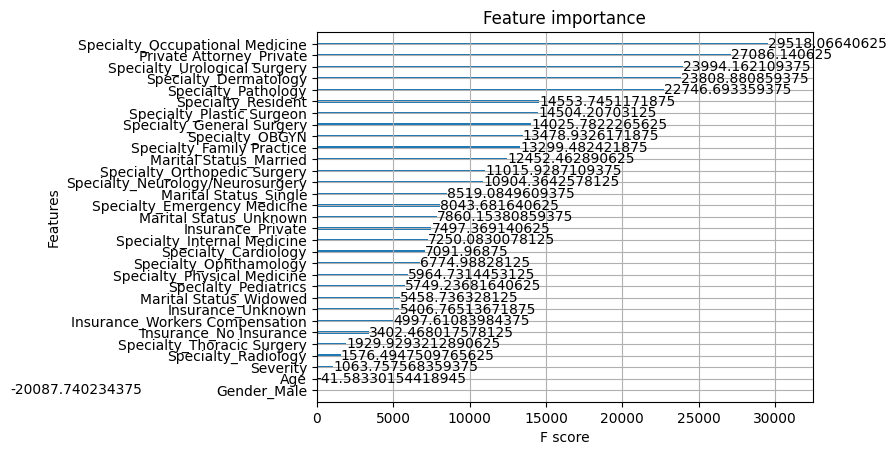

In [79]:
plot_importance(xgb)

***Conclusions***
* The mean (average) payment is 157,484 dollars, while the median (middle) is 98,131 dollars.
* The oldest patient in the data set is 87, the youngest a newborn. The average age is 42.7 and the median age is 43 years.
* 60.3% patients in this sample are female and 39.7% are male.
* Patients with private insurance coverage are the largest group in this sample, although apparently the type of insurance held by many patients is unknown. Workers compensation patients comprise the smallest group in this sample.
* There does not seem to be a notable difference in the distribution of Amount for males and females.
* Although there seems to be a difference in the distribution of Amount by Marital Status, the unbalanced data does not allow us to infer it is a correct conclusion.
* **The amount of the claim payment has a lot to do with whether a private attorney was used.**
* **It doesn’t matter if someone was female or male, if a private attorney was used the payout was generally much higher.**
* Some specialties are relevant when considering the amount paid. However, we must analyze each case as we can see so many different amounts paid in each category.
* **Finally, the predictions are not linear, since we are dealing with many different cases and judicial decisions are subjective. Therefore, the exclusion of outliers was considered and executed in the model.**